In [15]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from ydata_profiling import ProfileReport



## FUNCIONES 

In [16]:
def clean_value(x):
    if isinstance(x, str):
        x = x.replace('%', '').replace('$', '').replace(',', '')
        x = x.replace(' ', '')
    try:
        return float(x)
    except:
        return None
    
def plot_escenarios(df, variable):
    escenarios = [col for col in df.columns if col.startswith(variable)]
    
    plt.figure(figsize=(10, 6))
    for col in escenarios:
        plt.plot(df['Fecha'], df[col], label=col)
    
    plt.title(variable)
    plt.legend(loc="upper left", fontsize='x-small')
    plt.grid(True)
    plt.show()

## LECTURA DE DATOS

In [17]:

plt.style.use("seaborn-v0_8")
sns.set_context("talk")

# Ruta del archivo
ruta = r"C:\Users\ASUS\Documents\GitHub\tuya\BASE_DS.xlsx"

# Cargar BASE
base = pd.read_excel(ruta, sheet_name="BASE")

# Cargar MACROS
macros = pd.read_excel(ruta, sheet_name="MACROS")
# macros.columns = macros.columns.str.strip()
macros.columns = (
    macros.columns
    .str.replace('\n', ' ', regex=True)  # Reemplaza saltos de línea por espacio
    .str.replace('\s+', ' ', regex=True) # Colapsa espacios múltiples en uno solo
    .str.strip()                          # Quita espacios al inicio y fin
)
# Apply cleaning to all except the first column (Fecha)
for col in macros.columns[1:]:
    macros[col] = macros[col].apply(clean_value)

# Convertir fecha 
macros['Fecha'] = pd.to_datetime(macros['Fecha'], format="%b-%y", errors='coerce')


# Convertir fecha 
base['Fecha'] = pd.to_datetime(base['Fecha'], format="%b-%y", errors='coerce')
base.set_index('Fecha', inplace=True)


## ESTADISTICAS GENERALES

In [18]:
base_profile = ProfileReport(base , title = 'BASE REPORT ')
base_profile

Render HTML: 100%|██████████| 1/1 [00:00<00:00,  1.14it/s]


In [19]:
macros_profile = ProfileReport(macros , title = 'MACROS REPORT ')
macros_profile

Render HTML: 100%|██████████| 1/1 [00:18<00:00, 18.04s/it]


### Alertas Principales – Base de Datos

1. **Correlaciones Altas Entre Variables**
   - `aumento_recaudo` presenta una correlación muy alta con `dummy_colocaciones`.
   - `desembolsos` está fuertemente correlacionado con `estrategia_credicompras` y otras dos variables.
   - `dummy_colocaciones` muestra alta correlación con `aumento_recaudo`.
   - `estrategia_credicompras` se encuentra altamente correlacionada con `desembolsos`.
   - `facturacion` presenta alta correlación con `desembolsos` y otra variable adicional.
   - `saldo` presenta alta correlación con `desembolsos` y otra variable adicional.

2. **Calidad y Cantidad de Datos**
   - `facturacion` tiene 12 valores faltantes (25% del total).
   - `saldo` tiene 12 valores faltantes (25% del total).
   - `desembolsos` contiene 10 valores iguales a cero (20,8% del total).
   - Solo se dispone de **36 registros** para las variables `facturacion` y `saldo`.

---

### Alertas Principales – Variables Macroeconómicas
- Se identifican **altas correlaciones entre las variables macroeconómicas**.
- El número de observaciones disponibles para estas variables también es **36 registros**, lo cual limita el tamaño de la muestra para los análisis y los modelos.

## FUNCIONES 

In [20]:
def clean_value(x):
    if isinstance(x, str):
        x = x.replace('%', '').replace('$', '').replace(',', '')
        x = x.replace(' ', '')
    try:
        return float(x)
    except:
        return None
    
def plot_escenarios(df, variable):
    escenarios = [col for col in df.columns if col.startswith(variable)]
    
    plt.figure(figsize=(10, 6))
    for col in escenarios:
        plt.plot(df['Fecha'], df[col], label=col)
    
    plt.title(variable)
    plt.legend(loc="upper left", fontsize='x-small')
    plt.grid(True)
    plt.show()

## ANALYSIS BASE

In [21]:
# Crear crecimiento porcentual trimestral y anual
base['facturacion_growth_qoq'] = base['facturacion'].pct_change()
base['saldo_growth_qoq'] = base['saldo'].pct_change()

base['facturacion_growth_yoy'] = base['facturacion'].pct_change(4)
base['saldo_growth_yoy'] = base['saldo'].pct_change(4)

C:\Users\ASUS\AppData\Local\Temp\ipykernel_16872\1890819605.py:2: FutureWarning: The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  base['facturacion_growth_qoq'] = base['facturacion'].pct_change()
C:\Users\ASUS\AppData\Local\Temp\ipykernel_16872\1890819605.py:3: FutureWarning: The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or specify 'fill_method=None' to not fill NA values.
  base['saldo_growth_qoq'] = base['saldo'].pct_change()
C:\Users\ASUS\AppData\Local\Temp\ipykernel_16872\1890819605.py:5: FutureWarning: The default fill_method='pad' in Series.pct_change is deprecated and will be removed in a future version. Either fill in any non-leading NA values prior to calling pct_change or

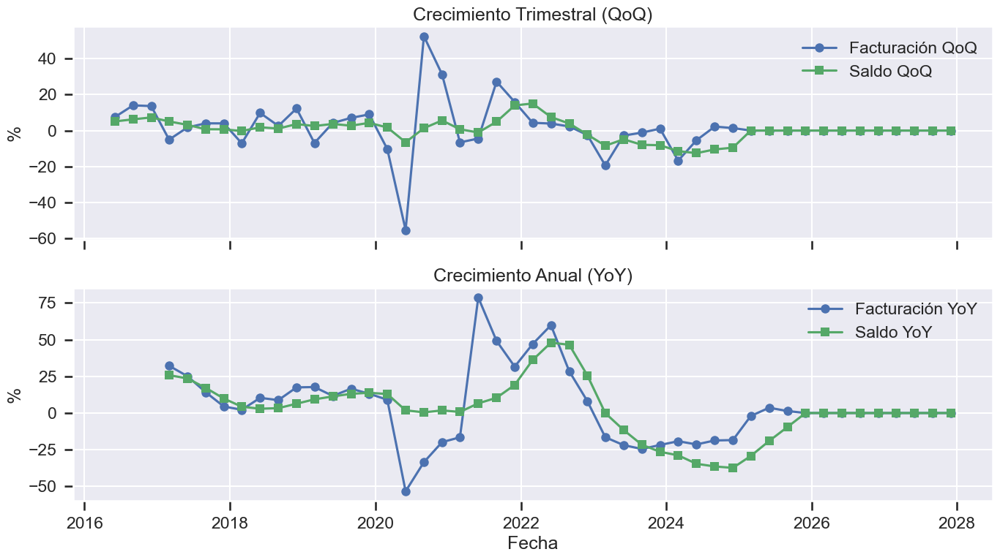

In [22]:
fig, axes = plt.subplots(2, 1, figsize=(14, 8), sharex=True)

# Gráfico QoQ
axes[0].plot(base.index, base['facturacion_growth_qoq']*100, marker='o', label='Facturación QoQ')
axes[0].plot(base.index, base['saldo_growth_qoq']*100, marker='s', label='Saldo QoQ')
axes[0].set_title('Crecimiento Trimestral (QoQ)')
axes[0].set_ylabel('%')
axes[0].legend()
axes[0].grid(True)

# Gráfico YoY
axes[1].plot(base.index, base['facturacion_growth_yoy']*100, marker='o', label='Facturación YoY')
axes[1].plot(base.index, base['saldo_growth_yoy']*100, marker='s', label='Saldo YoY')
axes[1].set_title('Crecimiento Anual (YoY)')
axes[1].set_ylabel('%')
axes[1].set_xlabel('Fecha')
axes[1].legend()
axes[1].grid(True)

plt.tight_layout()
plt.show()

### Tendencias de Facturación y Saldos
- La **volatilidad trimestral (QoQ)** de la facturación es elevada, con caídas pronunciadas en 2020, probablemente asociadas a factores macroeconómicos externos.
- Desde 2021, la facturación muestra un **repunte importante**, con una tendencia a estabilizarse hacia 2023, evidenciando una fase de maduración posterior a la recuperación.
- El **crecimiento anual (YoY)** resulta más estable y menos volátil que el QoQ, reforzando la importancia de evaluar ambas perspectivas.
- La variable **Saldo** muestra **mayor estabilidad y menor variabilidad** frente a Facturación, lo que sugiere una mayor resiliencia a cambios abruptos en el entorno.

## ANALYSIS ESCENARIOS

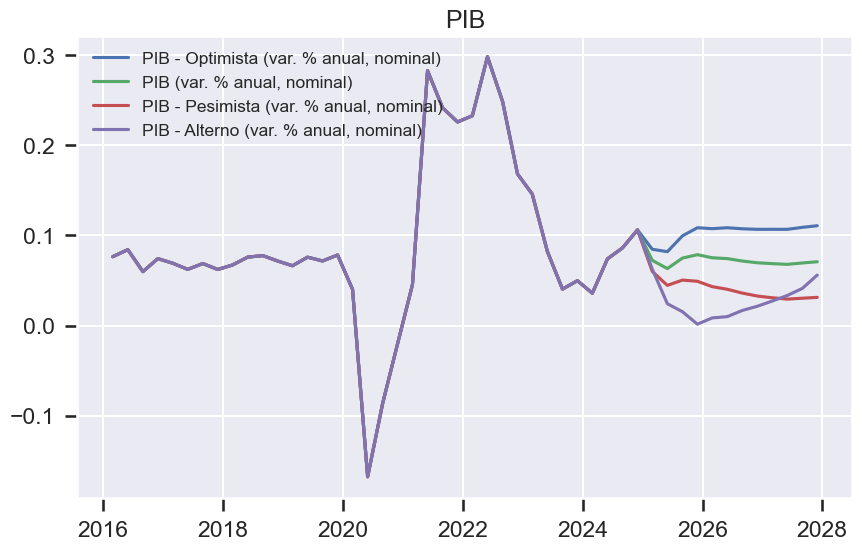

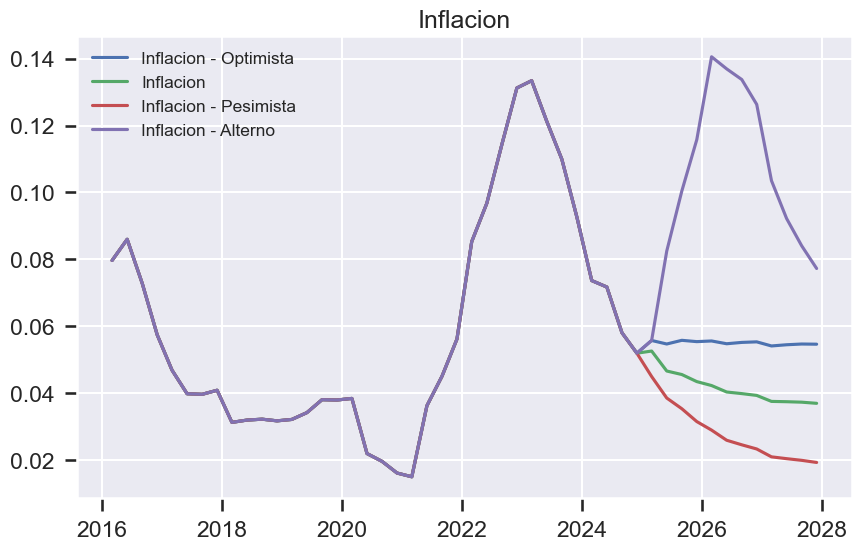

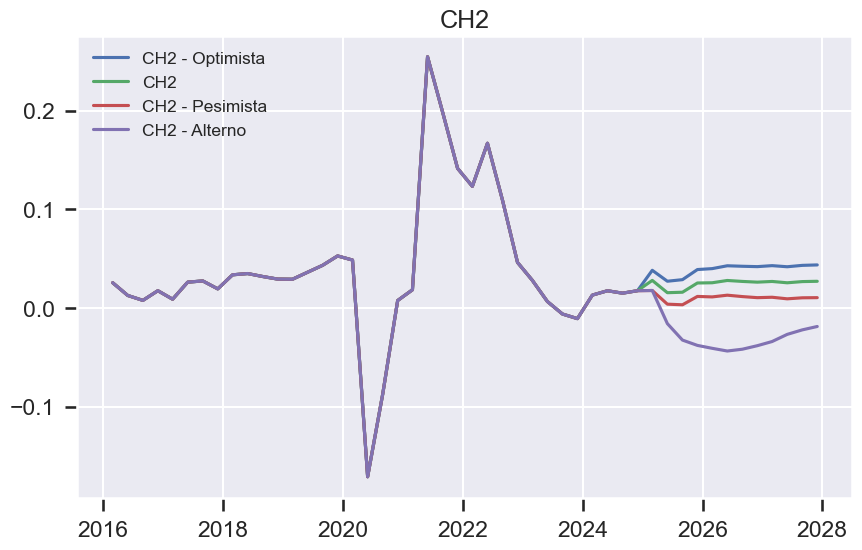

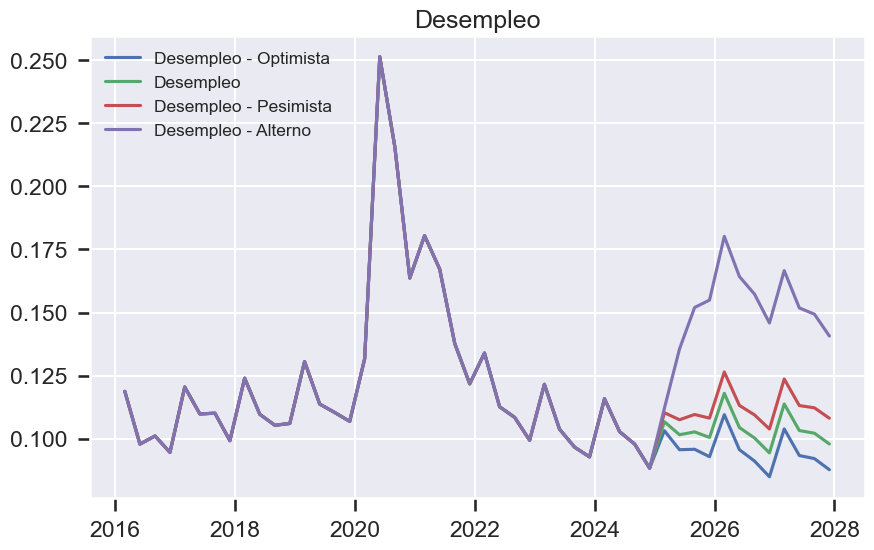

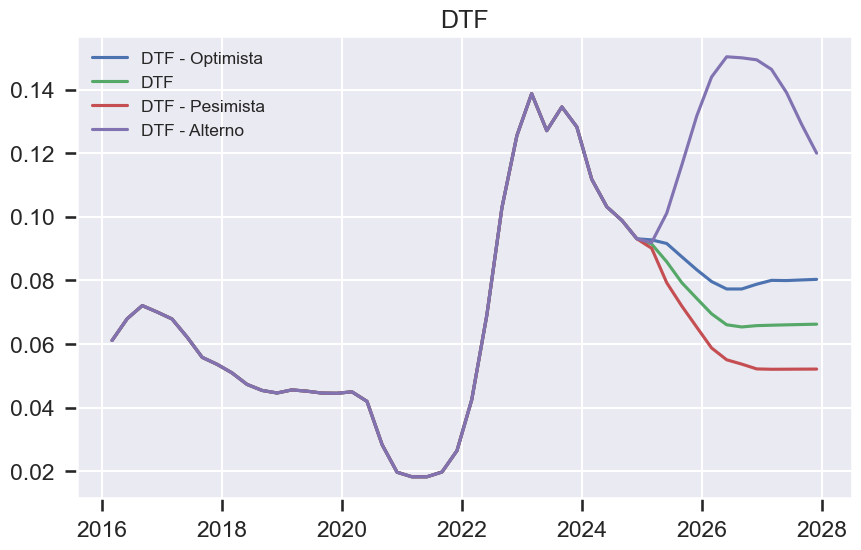

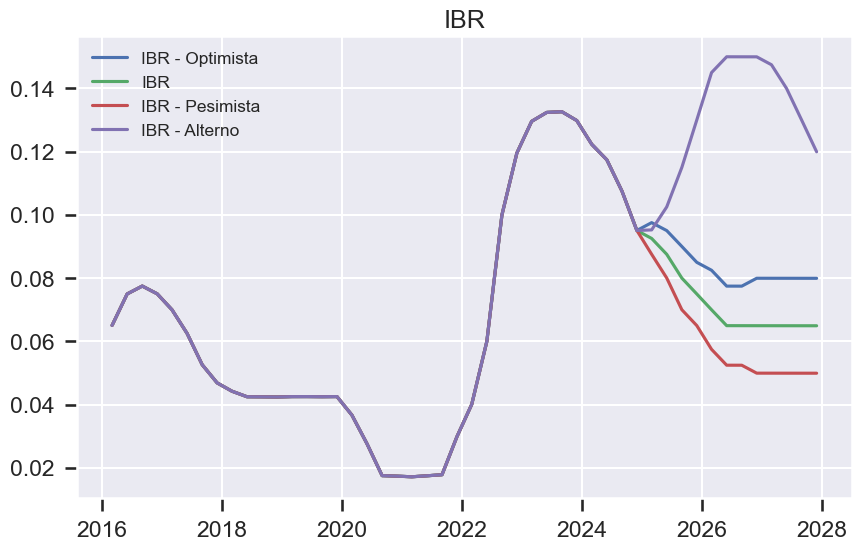

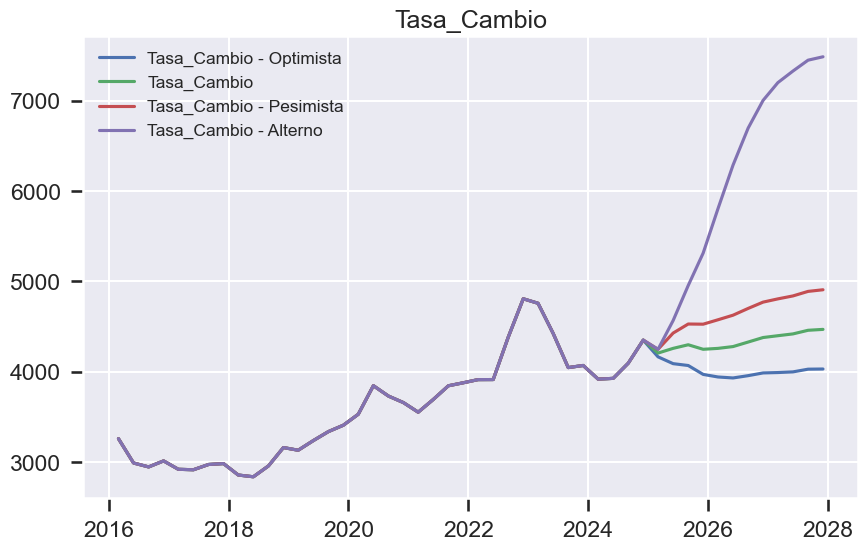

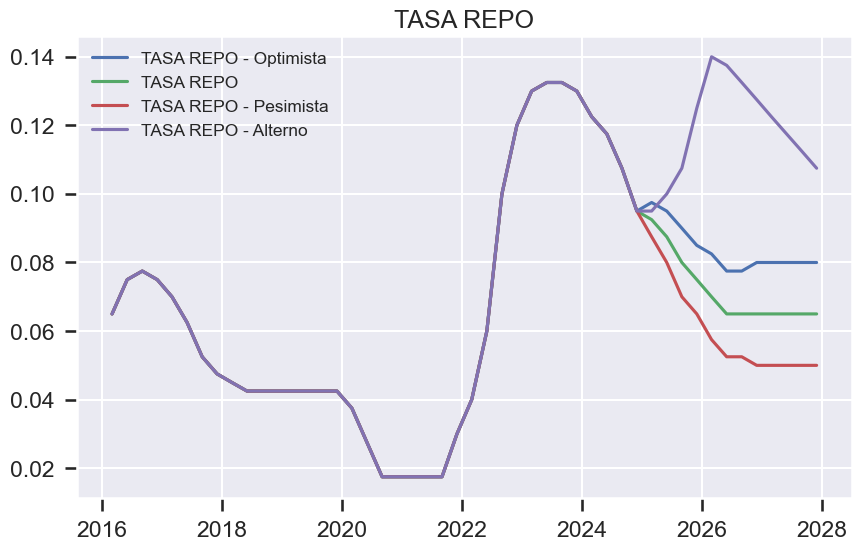

In [24]:
plot_escenarios(macros, 'PIB')
plot_escenarios(macros, 'Inflacion')
plot_escenarios(macros, 'CH2')
plot_escenarios(macros, 'Desempleo')   
plot_escenarios(macros, 'DTF')   
plot_escenarios(macros, 'IBR')   
plot_escenarios(macros, 'Tasa_Cambio')     
plot_escenarios(macros, 'TASA REPO')             

### Análisis de Escenarios
La definición de escenarios permite evaluar la resiliencia financiera de Tuya ante distintas condiciones económicas:

- **Escenario Pesimista:** Refleja las condiciones más desfavorables y riesgosas.
- **Escenario Base:** Representa la trayectoria central esperada bajo supuestos actuales.
- **Escenario Optimista:** Considera una evolución más positiva que el escenario base, con mejoras graduales en las condiciones económicas.
- **Escenario Alterno:** Proyecta el mejor comportamiento posible, donde los resultados superan las expectativas iniciales.


## CORRELACION

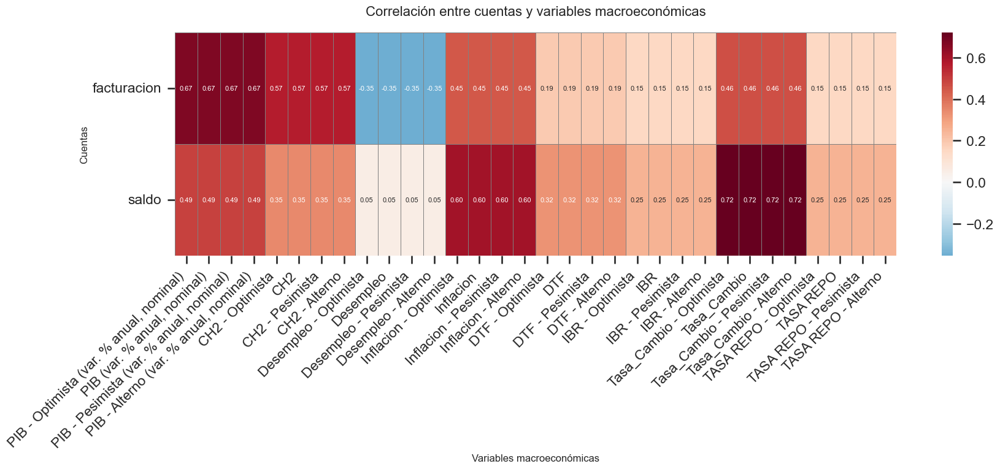

In [25]:
# Combinar los dataframes (left join para conservar todas las fechas de macros)
df = pd.merge(macros, base, on='Fecha', how='left')

# Listas de columnas
macro_vars = [c for c in macros.columns if c != 'Fecha']
cuentas_vars = ['facturacion', 'saldo'] # todas las cuentas del df base


# ===========
# MATRIZ DE CORRELACIÓN ENTRE MACROS Y CUENTAS
# ===========

# Crear un dataframe solo con macros y cuentas (sin la fecha)
corr_df = df[macro_vars + cuentas_vars]

# Calcular la matriz de correlación
corr = corr_df.corr(method='pearson')

# Opcional: enfocar el heatmap en cómo se relacionan las cuentas con las macros
# Filas: cuentas, Columnas: macros
corr_focus = corr.loc[cuentas_vars, macro_vars]

plt.figure(figsize=(18, 8))
sns.heatmap(
    corr_focus,
    annot=True,
    fmt=".2f",
    cmap="RdBu_r",
    center=0,
    linewidths=0.5,
    linecolor="gray",
    annot_kws={"size": 8}
)

plt.title("Correlación entre cuentas y variables macroeconómicas", fontsize=16, pad=20)
plt.xlabel("Variables macroeconómicas", fontsize=12)
plt.ylabel("Cuentas", fontsize=12)

# Rotar las etiquetas para mayor legibilidad
plt.xticks(rotation=45, ha='right')
plt.yticks(rotation=0)

plt.tight_layout()
plt.show()

### Correlación con Variables Macroeconómicas
El análisis confirma una **alta dependencia de las cuentas de Facturación y Saldo respecto a las condiciones macroeconómicas**:

#### Facturación
- Fuerte correlación positiva con el **crecimiento del PIB** en todos los escenarios.
- Correlación moderada con **inflación** y, en menor medida, con la **tasa de cambio**.
- Correlación negativa moderada con la **tasa de desempleo**, coherente con la expectativa de que mayores niveles de desempleo reducen el consumo y afectan la facturación.

#### Saldo
- La **tasa de cambio** (en todas sus variantes) muestra la correlación más fuerte con esta variable, evidenciando la importancia de la exposición cambiaria.
- Relación positiva significativa con **inflación** y **PIB**, aunque menos intensa que en el caso de la facturación.
- Correlación más baja con tasas de interés (DTF, IBR, REPO), lo cual indica que estas variables tienen un impacto secundario en comparación con la tasa de cambio y el PIB.

### Conclusiones Finales del EDA

- **Modelado con enfoques simples:**  
  Se optará por el uso de modelos relativamente simples como **SARIMAX**, **Prophet** y **Regresión Lineal Ridge**, dado que el número de observaciones disponibles es reducido y no permite el uso efectivo de modelos más complejos o de machine learning clásico.

- **Exclusión de variables dummies y desembolsos:**  
  Las variables **dummies** y **desembolsos** serán descartadas debido a la ausencia de información histórica suficiente y a la necesidad de aplicar métodos de imputación complejos para escenarios y años en los que no existen datos.  
  Por tanto, para la base interna solo se utilizarán **facturación** y **saldo**, las cuales constituyen las variables objetivo (target).

- **Selección robusta de variables macroeconómicas:**  
  En cuanto a las variables macroeconómicas, se emplearán técnicas más avanzadas de **selección de características** que permitan identificar los factores más relevantes y guiar la toma de decisiones en el modelado.